In [22]:
path = 'F:/UMich/J14_PM08_09_10_gaussian_fit_parameters_08272023.h5'
ds_para = RHEED_parameter_dataset(path, camera_freq=2000, sample_name='PM08')
ds_para.data_info

Growth: 30fps_temp600_later_stage:
--spot: spot_1:
----height:, Size of data: (507527,)
----img_max:, Size of data: (507527,)
----img_mean:, Size of data: (507527,)
----img_rec_max:, Size of data: (507527,)
----img_rec_mean:, Size of data: (507527,)
----img_rec_sum:, Size of data: (507527,)
----img_sum:, Size of data: (507527,)
----raw_image:, Size of data: (507527, 34, 16)
----reconstructed_image:, Size of data: (507527, 34, 16)
----width_x:, Size of data: (507527,)
----width_y:, Size of data: (507527,)
----x:, Size of data: (507527,)
----y:, Size of data: (507527,)
--spot: spot_2:
----height:, Size of data: (507527,)
----img_max:, Size of data: (507527,)
----img_mean:, Size of data: (507527,)
----img_rec_max:, Size of data: (507527,)
----img_rec_mean:, Size of data: (507527,)
----img_rec_sum:, Size of data: (507527,)
----img_sum:, Size of data: (507527,)
----raw_image:, Size of data: (507527, 41, 14)
----reconstructed_image:, Size of data: (507527, 41, 14)
----width_x:, Size of data:

In [6]:
import h5py

In [10]:
path = 'F:/UMich/J14_PM08_gaussian_fit_parameters_08272023.h5'
with h5py.File(path, 'r') as h5:
    raw_img = np.array(h5['temp500']['spot_2']['raw_image'])

In [11]:
raw_img.shape

(372226, 31, 25)

In [12]:
with h5py.File('F:/UMich/J14_PM08_09_10_gaussian_fit_parameters_08272023.h5', 'a') as h5_to:
    for file in ['F:/UMich/J14_PM09_gaussian_fit_parameters_08272023.h5', 
                 'F:/UMich/J14_PM10_gaussian_fit_parameters_08272023.h5']:
        with h5py.File(file, 'r') as h5_from1:
            for temp in h5_from1.keys():
                h5_to.create_group(temp)
                for spot in h5_from1[temp].keys():
                    h5_to[temp].create_group(spot)
                    for metric in h5_from1[temp][spot].keys():
                        data = h5_from1[temp][spot][metric]
                        h5_to[temp][spot].create_dataset(metric, data=data)


# RHEED Metrics with Details

In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
import glob
import sys
sys.path.append('../../src/')

import os
import re
import numpy as np
import matplotlib.pyplot as plt

from m3_learning.util.file_IO import download_and_unzip
from m3_learning.RHEED.Dataset import RHEED_spot_Dataset, RHEED_parameter_dataset
from m3_learning.RHEED.Viz import Viz
from m3_learning.RHEED.Fit import RHEED_image_processer, Gaussian

In [8]:
for file in glob.glob('E:/umich_rheed/*.h5'):
    print(file)
    ds_spot350C = RHEED_spot_Dataset(file, sample_name='test')
    ds_spot350C.data_info

E:/umich_rheed\J14_PM01_02_03_gaussian_fit_parameters_08242023.h5
Growth: temp250
Growth: temp300
Growth: temp350
E:/umich_rheed\J14_PM01_350C_08242023.h5
Growth: temp350, Size of data: f(601694, 480, 640)
E:/umich_rheed\J14_PM02_300C_08242023.h5
Growth: temp300, Size of data: f(630880, 480, 640)
E:/umich_rheed\J14_PM03_250C_08252023.h5
Growth: temp250, Size of data: f(605692, 480, 640)
E:/umich_rheed\J14_PM04_05_06_gaussian_fit_parameters_08252023.h5
Growth: temp250
Growth: temp250_later_stage
Growth: temp300
Growth: temp300_later_stage
Growth: temp350
E:/umich_rheed\J14_PM04_350C_08252023.h5
Growth: temp350, Size of data: f(477178, 480, 640)
Growth: temp350_later_stage, Size of data: f(449167, 480, 640)
E:/umich_rheed\J14_PM05_300C_08252023.h5
Growth: temp300, Size of data: f(366525, 480, 640)
Growth: temp300_later_stage, Size of data: f(172714, 480, 640)
E:/umich_rheed\J14_PM06_250C_08252023.h5
Growth: temp250, Size of data: f(499922, 480, 640)
Growth: temp250_later_stage, Size of d

In [2]:
path = 'F:/UMich/J14_set2_250C_08252023.h5'
ds_spot350C = RHEED_spot_Dataset(path, sample_name='J14_250C')
ds_spot350C.data_info

Growth: temp250, Size of data: f(499922, 480, 640)
Growth: temp250_later_stage, Size of data: f(509165, 480, 640)


In [4]:
import h5py
path = 'F:/UMich/J14_set2_250C_08252023.h5'
with h5py.File(path) as h5:
    print(h5.keys())
    for k in h5.keys():
        print(h5[k].shape)

<KeysViewHDF5 ['temp250', 'temp250_later_stage']>
(499922, 480, 640)
(509165, 480, 640)


In [ ]:
for ds_name_load, ds_name_create in zip(ds_names_load, ds_names_create):
    file_list = glob.glob(source_dir+'/'+ds_name_load+'.*')
    length = len(file_list)
    img_shape = plt.imread(file_list[0]).shape
    print(ds_name_load, ds_names_create, length, img_shape, plt.imread(file_list[0]).dtype)

    createdata = h5.create_dataset(ds_name_create, shape=(length, *img_shape), dtype=np.uint8)
    for i, file in enumerate(file_list):
        if i % 10000 == 0:
            print(f'{i} - {i+10000} ...')
        createdata[i] = plt.imread(file)

### 2.1 PM08

In [9]:
path = 'E:/umich_rheed/J14_PM08_500C_08272023.h5'
ds_spot350C = RHEED_spot_Dataset(path, sample_name='PM08')
ds_spot350C.data_info

Growth: temp500, Size of data: f(372226, 480, 640)


#### 2.1.2 Locate the diffraction spots

In [14]:
growth_name = 'temp500'
ds_spot350C.viz_RHEED_spot(growth=growth_name, index=250000, figsize=(8,6), viz_mode='iteractive')

Fig. a: RHEED spot image for temp500 at index 250000.


<Figure size 800x600 with 0 Axes>

#### 2.1.3 Visualize an example

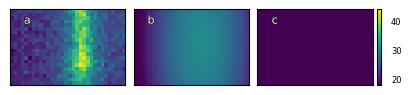

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500 at index 0.
The Gaussian fitted parameters are: img_sum=17394.00, img_max=44.00, img_mean=25.88,
img_rec_sum=17267.67, img_rec_max=30.45, img_rec_mean=25.70,
height=30.45, x=8.93, y=18.75, width_x=39.11, width_y_max=17.06.


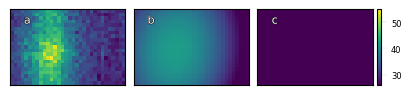

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500 at index 250000.
The Gaussian fitted parameters are: img_sum=24155.00, img_max=55.00, img_mean=35.94,
img_rec_sum=23804.25, img_rec_max=42.17, img_rec_mean=35.42,
height=42.17, x=11.42, y=11.62, width_x=25.26, width_y_max=18.95.


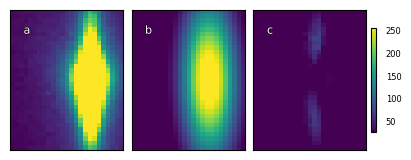

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500 at index 0.
The Gaussian fitted parameters are: img_sum=80311.00, img_max=255.00, img_mean=103.63,
img_rec_sum=69472.00, img_rec_max=285.01, img_rec_mean=89.64,
height=286.39, x=15.58, y=17.09, width_x=12.24, width_y_max=4.30.


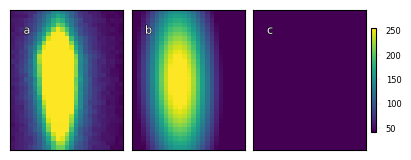

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500 at index 250000.
The Gaussian fitted parameters are: img_sum=95049.00, img_max=255.00, img_mean=122.64,
img_rec_sum=86862.38, img_rec_max=276.17, img_rec_mean=112.08,
height=276.44, x=15.85, y=10.24, width_x=14.51, width_y_max=5.19.


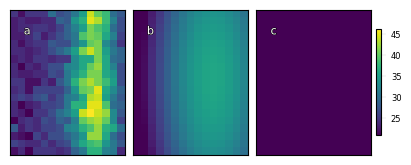

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500 at index 0.
The Gaussian fitted parameters are: img_sum=8577.00, img_max=46.00, img_mean=30.09,
img_rec_sum=8566.60, img_rec_max=35.84, img_rec_mean=30.06,
height=35.85, x=8.87, y=10.68, width_x=26.74, width_y_max=9.66.


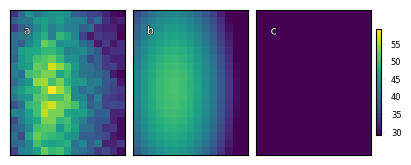

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500 at index 250000.
The Gaussian fitted parameters are: img_sum=11960.00, img_max=59.00, img_mean=41.96,
img_rec_sum=11603.41, img_rec_max=50.42, img_rec_mean=40.71,
height=50.45, x=10.47, y=5.07, width_x=18.15, width_y_max=8.69.


In [22]:
crop_dict = {'spot_1': {'y_start':199, 'y_end':220, 'x_start':228, 'x_end':260}, 
             'spot_2': {'y_start':189, 'y_end':220, 'x_start':309, 'x_end':334}, 
             'spot_3': {'y_start':199, 'y_end':218, 'x_start':395, 'x_end':410}}
start_index, end_index = 0, 250000
fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(ds_spot350C, crop_dict, fit_function)
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_1', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_1', frame=end_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_2', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_2', frame=end_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_3', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_3', frame=end_index, figsize=(4,8))

#### 2.1.4 preview metric in time

In [ ]:
# %%time
# fit_function = Gaussian().recreate_gaussian
# processor = RHEED_image_processer(ds_spot350C, crop_dict, fit_function)
# processor.preview_metric(growth='temp350', spot='spot_2', metric='mean', 
#                          camera_freq=2000)

#### 2.1.4 generate the dataset

In [23]:
%%time
parameters_file_path = 'F:/UMich/J14_PM08_gaussian_fit_parameters_08272023.h5'
growth_names = [growth_name]

fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(ds_spot350C, crop_dict, fit_function)
processor.write_h5_file(parameters_file_path, growth_names, replace=False, num_workers=12)

temp500:
  spot_1 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 372226 ...
  spot_2 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 372226 ...
  spot_3 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 372226 ...
CPU times: total: 10min 50s
Wall time: 45min 48s


#### 2.1.5 Exam the dataset

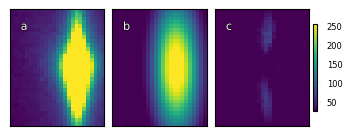

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500 at index 0.
img_sum=80311.00, img_max=255.00, img_mean=103.63
img_rec_sum=69472.00, img_rec_max=285.01, img_rec_mean=89.64
height=286.39, x=15.58, y=17.09, width_x=12.24, width_y_max=4.30


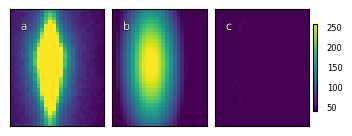

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500 at index 125000.
img_sum=89002.00, img_max=255.00, img_mean=114.84
img_rec_sum=80262.60, img_rec_max=264.95, img_rec_mean=103.56
height=265.27, x=14.50, y=10.16, width_x=13.41, width_y_max=5.15


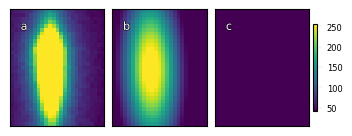

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500 at index 250000.
img_sum=95049.00, img_max=255.00, img_mean=122.64
img_rec_sum=86862.38, img_rec_max=276.17, img_rec_mean=112.08
height=276.44, x=15.85, y=10.24, width_x=14.51, width_y_max=5.19


I:\RHEED_data\m3_learning\m3_learning\papers\2023_RHEED_PLD_SrTiO3 - UMich\../../src\m3_learning\RHEED\Dataset.py:432: UserWarning:

FixedFormatter should only be used together with FixedLocator



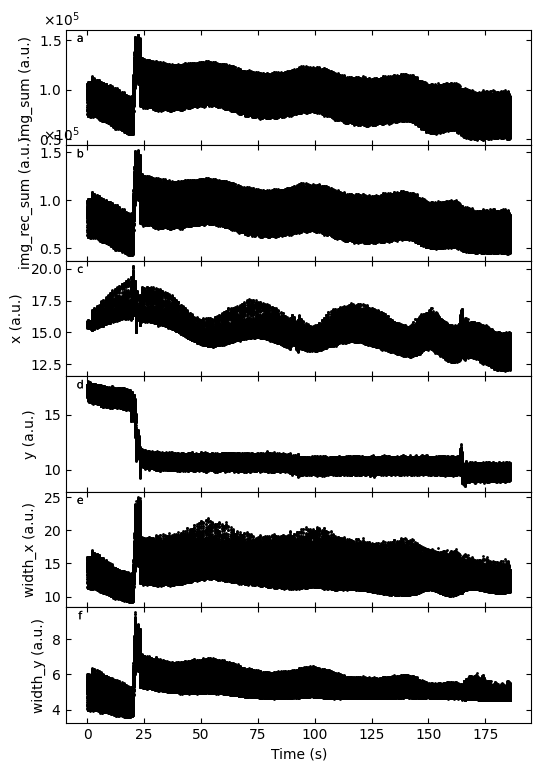

Gaussian fitted parameters in time: Fig. a: sum of original image, b: sum of reconstructed image, c: spot center in spot x coordinate, d: spot center in y coordinate, e: spot width in x coordinate, f: spot width in y coordinate.


In [24]:
parameters_file_path = 'F:/UMich/J14_PM08_gaussian_fit_parameters_08272023.h5'
D1_para = RHEED_parameter_dataset(parameters_file_path, camera_freq=2000, sample_name='PM08')

D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=start_index)
D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index//2)
D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index)
D1_para.viz_RHEED_parameter_trend(growth_names, spot='spot_2', head_tail=(100,300))

### 2.2 PM08_later_stage

In [14]:
path = 'E:/umich_rheed/J14_PM08_500C_later_stage.h5'
ds_PM08 = RHEED_spot_Dataset(path, sample_name='PM08')
ds_PM08.data_info

Growth: temp500_later_stage, Size of data: f(450229, 480, 640)


#### 2.2.2 Locate the diffraction spots

In [15]:
growth_name = 'temp500_later_stage'
ds_PM08.viz_RHEED_spot(growth=growth_name, index=0, figsize=(8,6), viz_mode='iteractive')

Fig. a: RHEED spot image for temp500_later_stage at index 0.


<Figure size 800x600 with 0 Axes>

#### 2.2.3 Visualize an example

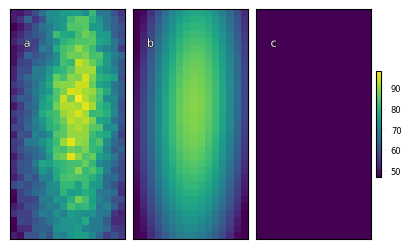

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500_later_stage at index 0.
The Gaussian fitted parameters are: img_sum=36424.00, img_max=98.00, img_mean=71.14,
img_rec_sum=35675.74, img_rec_max=88.67, img_rec_mean=69.68,
height=88.67, x=13.52, y=8.58, width_x=26.36, width_y_max=8.09.


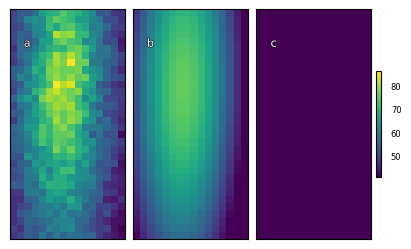

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500_later_stage at index 450000.
The Gaussian fitted parameters are: img_sum=31214.00, img_max=86.00, img_mean=60.96,
img_rec_sum=30300.82, img_rec_max=75.19, img_rec_mean=59.18,
height=75.35, x=10.68, y=6.92, width_x=29.11, width_y_max=8.21.


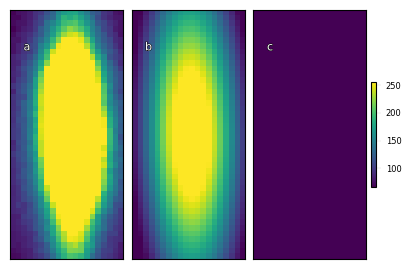

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500_later_stage at index 0.
The Gaussian fitted parameters are: img_sum=157471.00, img_max=255.00, img_mean=178.94,
img_rec_sum=152466.65, img_rec_max=295.41, img_rec_mean=173.26,
height=295.47, x=21.86, y=10.46, width_x=21.42, width_y_max=6.56.


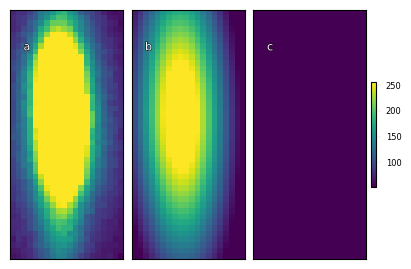

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500_later_stage at index 450000.
The Gaussian fitted parameters are: img_sum=140313.00, img_max=255.00, img_mean=159.45,
img_rec_sum=133157.31, img_rec_max=292.24, img_rec_mean=151.32,
height=292.35, x=18.72, y=8.55, width_x=19.06, width_y_max=5.91.


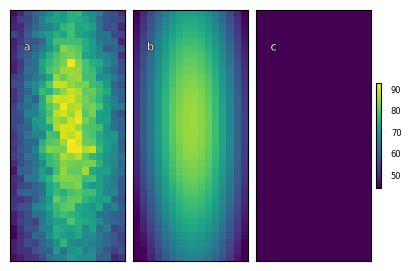

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500_later_stage at index 0.
The Gaussian fitted parameters are: img_sum=38238.00, img_max=93.00, img_mean=68.28,
img_rec_sum=37381.93, img_rec_max=85.73, img_rec_mean=66.75,
height=85.83, x=15.74, y=8.17, width_x=26.35, width_y_max=8.04.


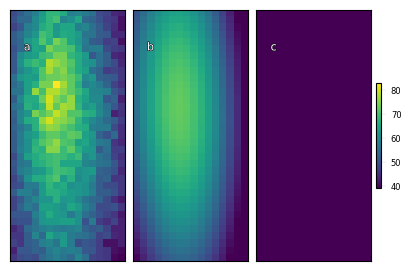

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500_later_stage at index 450000.
The Gaussian fitted parameters are: img_sum=32887.00, img_max=83.00, img_mean=58.73,
img_rec_sum=31937.06, img_rec_max=72.44, img_rec_mean=57.03,
height=72.44, x=13.54, y=6.35, width_x=27.89, width_y_max=8.68.


In [16]:
crop_dict = {'spot_1': {'y_start':156, 'y_end':188, 'x_start':237, 'x_end':253}, 
             'spot_2': {'y_start':146, 'y_end':190, 'x_start':317, 'x_end':337}, 
             'spot_3': {'y_start':153, 'y_end':188, 'x_start':401, 'x_end':417}}
start_index, end_index = 0, 450000
fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(ds_PM08, crop_dict, fit_function)
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_1', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_1', frame=end_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_2', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_2', frame=end_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_3', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_3', frame=end_index, figsize=(4,8))

#### 2.2.4 preview metric in time

In [ ]:
%%time
fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(ds_PM08, crop_dict, fit_function)
processor.preview_metric(growth='temp500_later_stage', spot='spot_2', metric='mean', 
                         camera_freq=2000)

0 - 50000 ...


#### 2.1.4 generate the dataset

In [18]:
%%time
parameters_file_path = 'F:/UMich/J14_PM08_gaussian_fit_parameters_08272023.h5'
growth_names = [growth_name]

fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(ds_PM08, crop_dict, fit_function)

processor.write_h5_file(parameters_file_path, growth_names, replace=False, num_workers=12)

h5 file exist.
temp500_later_stage:
  spot_1 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 400000 ...
    400000 - 450000 ...
    450000 - 450229 ...
  spot_2 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 400000 ...
    400000 - 450000 ...
    450000 - 450229 ...
  spot_3 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 400000 ...
    400000 - 450000 ...
    450000 - 450229 ...
CPU times: total: 11min 9s
Wall time: 47min 1s


In [19]:
%%time
parameters_file_path = 'F:/UMich/J14_PM08_09_10_gaussian_fit_parameters_08272023.h5'
growth_names = [growth_name]

fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(ds_PM08, crop_dict, fit_function)

processor.write_h5_file(parameters_file_path, growth_names, replace=False, num_workers=12)

h5 file exist.
temp500_later_stage:
  spot_1 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 400000 ...
    400000 - 450000 ...
    450000 - 450229 ...
  spot_2 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 400000 ...
    400000 - 450000 ...
    450000 - 450229 ...
  spot_3 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 400000 ...
    400000 - 450000 ...
    450000 - 450229 ...
CPU times: total: 11min 26s
Wall time: 46min 33s


#### 2.2.5 Exam the dataset

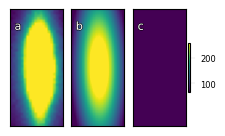

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500_later_stage at index 0.
img_sum=157471.00, img_max=255.00, img_mean=178.94
img_rec_sum=152466.65, img_rec_max=295.41, img_rec_mean=173.26
height=295.47, x=21.86, y=10.46, width_x=21.42, width_y_max=6.56


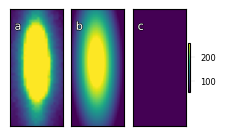

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500_later_stage at index 225000.
img_sum=135252.00, img_max=255.00, img_mean=153.70
img_rec_sum=128609.48, img_rec_max=294.64, img_rec_mean=146.15
height=294.80, x=19.97, y=9.38, width_x=17.57, width_y_max=-5.73


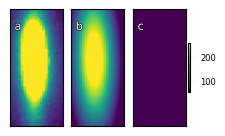

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500_later_stage at index 450000.
img_sum=140313.00, img_max=255.00, img_mean=159.45
img_rec_sum=133157.31, img_rec_max=292.24, img_rec_mean=151.32
height=292.35, x=18.72, y=8.55, width_x=19.06, width_y_max=5.91


I:\RHEED_data\m3_learning\m3_learning\papers\2023_RHEED_PLD_SrTiO3 - UMich\../../src\m3_learning\RHEED\Dataset.py:432: UserWarning:

FixedFormatter should only be used together with FixedLocator



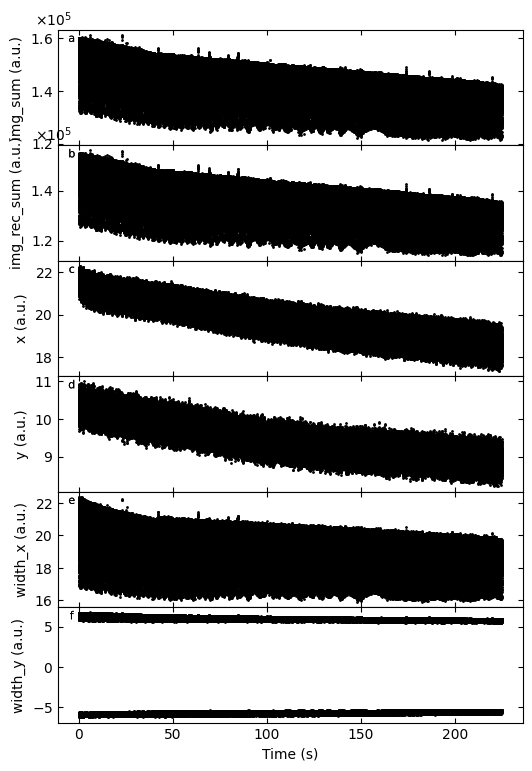

Gaussian fitted parameters in time: Fig. a: sum of original image, b: sum of reconstructed image, c: spot center in spot x coordinate, d: spot center in y coordinate, e: spot width in x coordinate, f: spot width in y coordinate.


In [20]:
parameters_file_path = 'F:/UMich/J14_PM08_gaussian_fit_parameters_08272023.h5'
D1_para = RHEED_parameter_dataset(parameters_file_path, camera_freq=2000, sample_name='PM08')

D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=start_index)
D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index//2)
D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index)
D1_para.viz_RHEED_parameter_trend(growth_names, spot='spot_2', head_tail=(100,300))

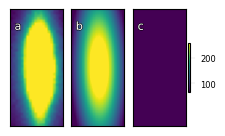

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500_later_stage at index 0.
img_sum=157471.00, img_max=255.00, img_mean=178.94
img_rec_sum=152466.65, img_rec_max=295.41, img_rec_mean=173.26
height=295.47, x=21.86, y=10.46, width_x=21.42, width_y_max=6.56


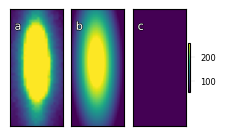

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500_later_stage at index 225000.
img_sum=135252.00, img_max=255.00, img_mean=153.70
img_rec_sum=128609.48, img_rec_max=294.64, img_rec_mean=146.15
height=294.80, x=19.97, y=9.38, width_x=17.57, width_y_max=-5.73


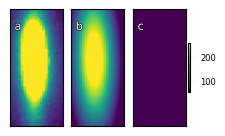

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp500_later_stage at index 450000.
img_sum=140313.00, img_max=255.00, img_mean=159.45
img_rec_sum=133157.31, img_rec_max=292.24, img_rec_mean=151.32
height=292.35, x=18.72, y=8.55, width_x=19.06, width_y_max=5.91


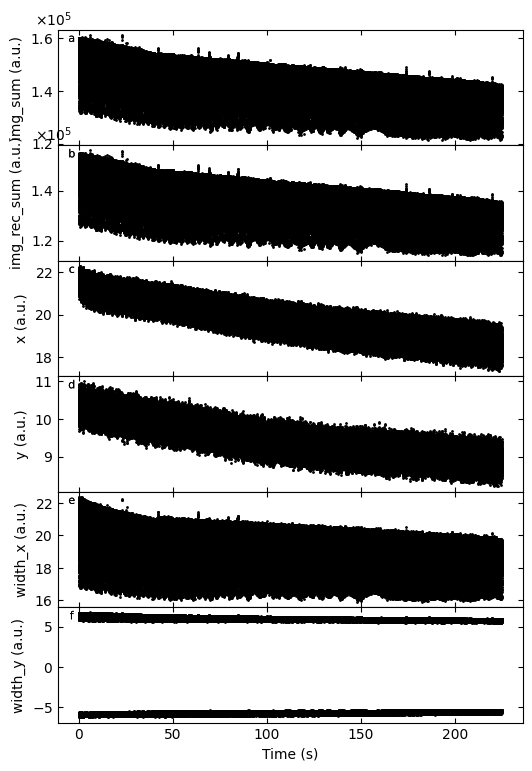

Gaussian fitted parameters in time: Fig. a: sum of original image, b: sum of reconstructed image, c: spot center in spot x coordinate, d: spot center in y coordinate, e: spot width in x coordinate, f: spot width in y coordinate.


In [21]:
parameters_file_path = 'F:/UMich/J14_PM08_09_10_gaussian_fit_parameters_08272023.h5'
D1_para = RHEED_parameter_dataset(parameters_file_path, camera_freq=2000, sample_name='PM08')

D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=start_index)
D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index//2)
D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index)
D1_para.viz_RHEED_parameter_trend(growth_names, spot='spot_2', head_tail=(100,300))

### 2.3 PM09

In [23]:
path = 'E:/umich_rheed/J14_PM09_550C_08272023.h5'
ds_PM09 = RHEED_spot_Dataset(path, sample_name='PM09')
ds_PM09.data_info

Growth: temp550, Size of data: f(422006, 480, 640)
Growth: temp550_later_stage, Size of data: f(411806, 480, 640)


#### 2.2.2 Locate the diffraction spots

In [24]:
growth_name = 'temp550'
ds_PM09.viz_RHEED_spot(growth=growth_name, index=10000, figsize=(8,6), viz_mode='iteractive')

Fig. a: RHEED spot image for temp550 at index 10000.


<Figure size 800x600 with 0 Axes>

#### 2.2.3 Visualize an example

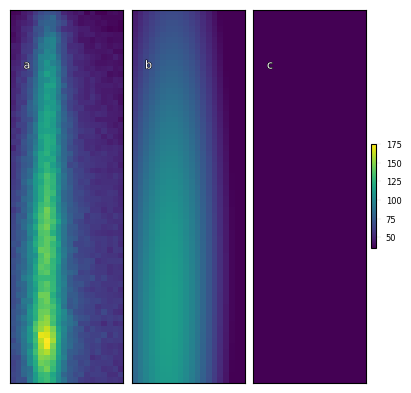

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550 at index 0.
The Gaussian fitted parameters are: img_sum=99174.00, img_max=175.00, img_mean=75.13,
img_rec_sum=95039.28, img_rec_max=114.29, img_rec_mean=72.00,
height=114.31, x=54.47, y=6.20, width_x=52.31, width_y_max=-7.81.


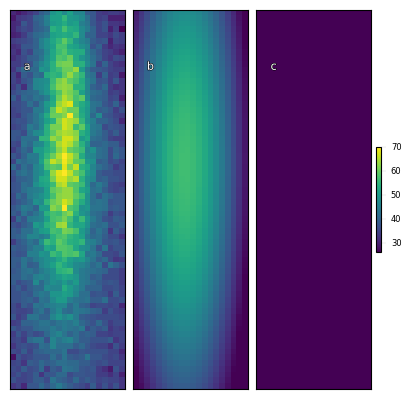

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550 at index 422000.
The Gaussian fitted parameters are: img_sum=57400.00, img_max=70.00, img_mean=43.48,
img_rec_sum=55997.93, img_rec_max=56.56, img_rec_mean=42.42,
height=56.61, x=26.81, y=9.07, width_x=45.58, width_y_max=-9.43.


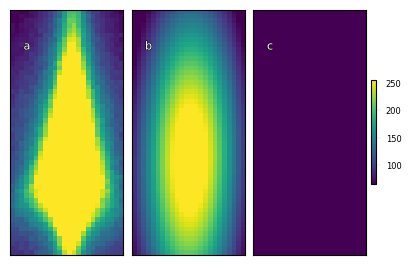

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550 at index 0.
The Gaussian fitted parameters are: img_sum=216699.00, img_max=255.00, img_mean=173.64,
img_rec_sum=211514.01, img_rec_max=282.97, img_rec_mean=169.48,
height=283.16, x=31.88, y=12.23, width_x=25.86, width_y_max=8.22.


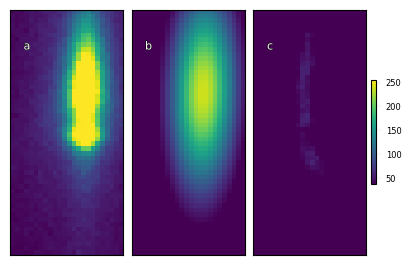

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550 at index 422000.
The Gaussian fitted parameters are: img_sum=107188.00, img_max=255.00, img_mean=85.89,
img_rec_sum=91241.67, img_rec_max=239.00, img_rec_mean=73.11,
height=240.02, x=17.38, y=15.19, width_x=14.81, width_y_max=5.13.


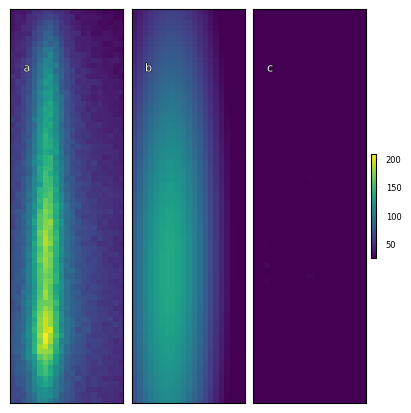

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550 at index 0.
The Gaussian fitted parameters are: img_sum=119390.00, img_max=208.00, img_mean=77.88,
img_rec_sum=112129.99, img_rec_max=135.59, img_rec_mean=73.14,
height=135.78, x=48.82, y=6.66, width_x=38.31, width_y_max=-6.73.


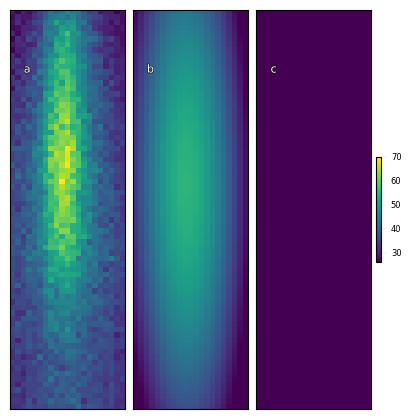

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550 at index 422000.
The Gaussian fitted parameters are: img_sum=63502.00, img_max=70.00, img_mean=41.42,
img_rec_sum=62050.05, img_rec_max=54.56, img_rec_mean=40.48,
height=54.58, x=31.82, y=9.69, width_x=46.76, width_y_max=-9.83.


In [25]:
crop_dict = {'spot_1': {'y_start':170, 'y_end':236, 'x_start':227, 'x_end':247}, 
             'spot_2': {'y_start':198, 'y_end':250, 'x_start':301, 'x_end':325}, 
             'spot_3': {'y_start':167, 'y_end':240, 'x_start':388, 'x_end':409}}
start_index, end_index = 0, 422000
fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(ds_PM09, crop_dict, fit_function)
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_1', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_1', frame=end_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_2', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_2', frame=end_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_3', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_3', frame=end_index, figsize=(4,8))

#### 2.2.4 preview metric in time

In [ ]:
# %%time
# fit_function = Gaussian().recreate_gaussian
# processor = RHEED_image_processer(D1_spot, crop_dict, fit_function)
# processor.preview_metric(growth='temp350', spot='spot_2', metric='mean', 
#                          camera_freq=2000)

#### 2.1.4 generate the dataset

In [29]:
%%time
parameters_file_path = 'F:/UMich/J14_PM09_gaussian_fit_parameters_08272023.h5'
growth_names = [growth_name]

fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(ds_PM09, crop_dict, fit_function)

processor.write_h5_file(parameters_file_path, growth_names, replace=False, num_workers=12)

temp550:
  spot_1 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 400000 ...
    400000 - 422006 ...
  spot_2 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 400000 ...
    400000 - 422006 ...
  spot_3 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 400000 ...
    400000 - 422006 ...
CPU times: total: 15min 24s
Wall time: 1h 39min 19s


#### 2.2.5 Exam the dataset

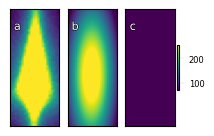

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550 at index 0.
img_sum=207040.00, img_max=255.00, img_mean=180.98
img_rec_sum=201226.14, img_rec_max=287.57, img_rec_mean=175.90
height=287.62, x=29.33, y=10.37, width_x=24.67, width_y_max=-7.93


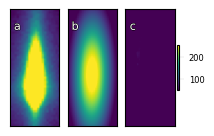

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550 at index 205000.
img_sum=153245.00, img_max=255.00, img_mean=133.96
img_rec_sum=145266.85, img_rec_max=277.25, img_rec_mean=126.98
height=277.31, x=29.22, y=10.53, width_x=18.82, width_y_max=-6.00


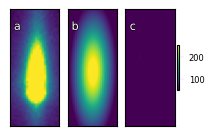

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550 at index 410000.
img_sum=141112.00, img_max=255.00, img_mean=123.35
img_rec_sum=132590.74, img_rec_max=269.41, img_rec_mean=115.90
height=270.48, x=27.78, y=10.99, width_x=16.93, width_y_max=-5.88


I:\RHEED_data\m3_learning\m3_learning\papers\2023_RHEED_PLD_SrTiO3 - UMich\../../src\m3_learning\RHEED\Dataset.py:432: UserWarning:

FixedFormatter should only be used together with FixedLocator



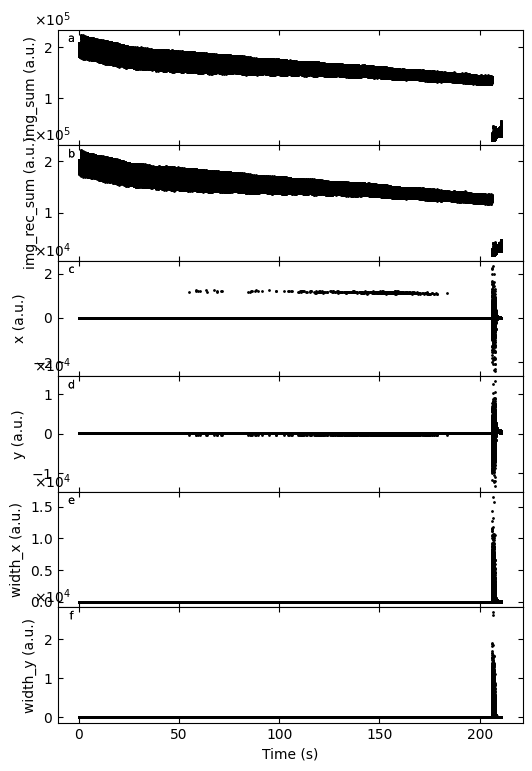

Gaussian fitted parameters in time: Fig. a: sum of original image, b: sum of reconstructed image, c: spot center in spot x coordinate, d: spot center in y coordinate, e: spot width in x coordinate, f: spot width in y coordinate.


In [30]:
parameters_file_path = 'F:/UMich/J14_PM09_gaussian_fit_parameters_08272023.h5'
para_PM09 = RHEED_parameter_dataset(parameters_file_path, camera_freq=2000, sample_name='PM09')

para_PM09.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=start_index)
para_PM09.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index//2)
para_PM09.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index)
para_PM09.viz_RHEED_parameter_trend(growth_names, spot='spot_2', head_tail=(100,300))

### 2.4 PM09_later_stage

In [31]:
path = 'E:/umich_rheed/J14_PM09_550C_08272023.h5'
ds_PM09 = RHEED_spot_Dataset(path, sample_name='PM09')
ds_PM09.data_info

Growth: temp550, Size of data: f(422006, 480, 640)
Growth: temp550_later_stage, Size of data: f(411806, 480, 640)


#### 2.4.2 Locate the diffraction spots

In [32]:
growth_name = 'temp550_later_stage'
ds_PM09.viz_RHEED_spot(growth=growth_name, index=10000, figsize=(8,6), viz_mode='iteractive')

Fig. a: RHEED spot image for temp550_later_stage at index 10000.


<Figure size 800x600 with 0 Axes>

#### 2.4.3 Visualize an example

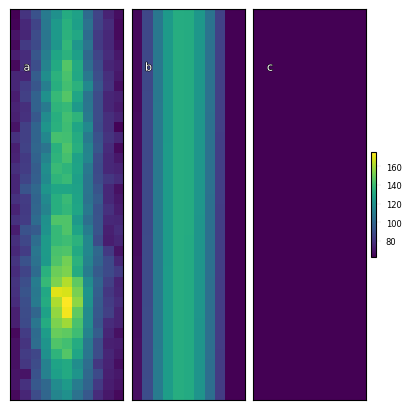

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550_later_stage at index 0.
The Gaussian fitted parameters are: img_sum=42868.00, img_max=175.00, img_mean=102.56,
img_rec_sum=40557.84, img_rec_max=132.94, img_rec_mean=97.03,
height=133.49, x=1293.54, y=0.94, width_x=4.10, width_y_max=69441.84.


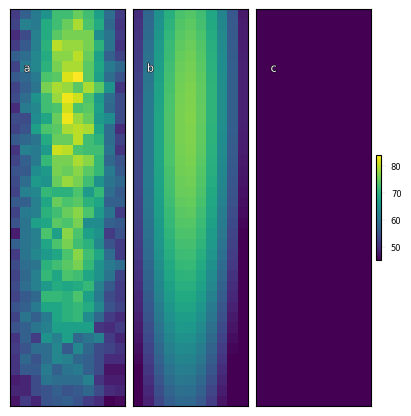

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550_later_stage at index 410000.
The Gaussian fitted parameters are: img_sum=26447.00, img_max=84.00, img_mean=63.27,
img_rec_sum=25612.43, img_rec_max=76.55, img_rec_mean=61.27,
height=76.66, x=10.53, y=5.18, width_x=37.26, width_y_max=-6.08.


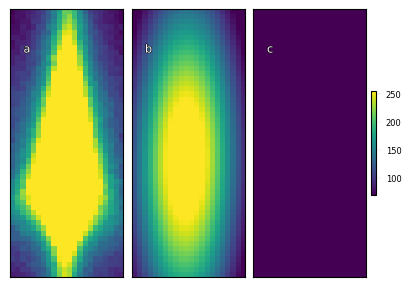

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550_later_stage at index 0.
The Gaussian fitted parameters are: img_sum=207040.00, img_max=255.00, img_mean=180.98,
img_rec_sum=201226.14, img_rec_max=287.57, img_rec_mean=175.90,
height=287.62, x=29.33, y=10.37, width_x=24.67, width_y_max=-7.93.


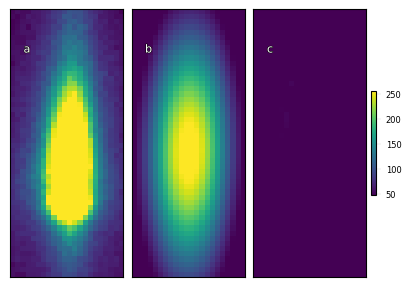

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550_later_stage at index 410000.
The Gaussian fitted parameters are: img_sum=141112.00, img_max=255.00, img_mean=123.35,
img_rec_sum=132590.74, img_rec_max=269.41, img_rec_mean=115.90,
height=270.48, x=27.78, y=10.99, width_x=16.93, width_y_max=-5.88.


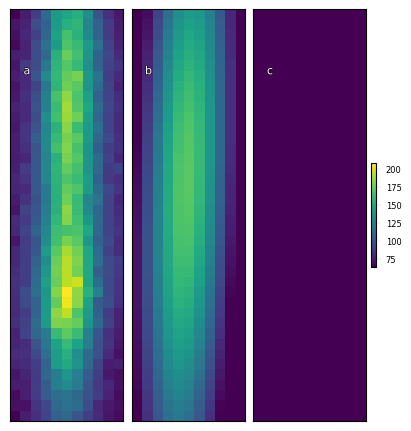

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550_later_stage at index 0.
The Gaussian fitted parameters are: img_sum=51117.00, img_max=208.00, img_mean=116.17,
img_rec_sum=47929.27, img_rec_max=170.90, img_rec_mean=108.93,
height=171.44, x=19123.41, y=-649.96, width_x=3.79, width_y_max=-27.89.


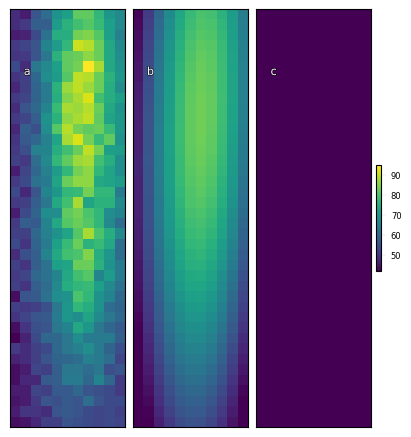

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550_later_stage at index 410000.
The Gaussian fitted parameters are: img_sum=28904.00, img_max=95.00, img_mean=65.69,
img_rec_sum=28347.63, img_rec_max=83.47, img_rec_mean=64.43,
height=83.48, x=9.92, y=6.65, width_x=33.35, width_y_max=6.18.


In [33]:
crop_dict = {'spot_1': {'y_start':200, 'y_end':238, 'x_start':228, 'x_end':239}, 
             'spot_2': {'y_start':200, 'y_end':252, 'x_start':303, 'x_end':325}, 
             'spot_3': {'y_start':200, 'y_end':240, 'x_start':389, 'x_end':400}}
start_index, end_index = 0, 410000
fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(ds_PM09, crop_dict, fit_function)
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_1', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_1', frame=end_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_2', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_2', frame=end_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_3', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_3', frame=end_index, figsize=(4,8))

#### 2.4.4 preview metric in time

In [ ]:
# %%time
# fit_function = Gaussian().recreate_gaussian
# processor = RHEED_image_processer(D1_spot, crop_dict, fit_function)
# processor.preview_metric(growth='temp350', spot='spot_2', metric='mean', 
#                          camera_freq=2000)

#### 2.4.4 generate the dataset

In [34]:
%%time
parameters_file_path = 'F:/UMich/J14_PM09_gaussian_fit_parameters_08272023.h5'
growth_names = [growth_name]

fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(ds_PM09, crop_dict, fit_function)

processor.write_h5_file(parameters_file_path, growth_names, replace=False, num_workers=12)

h5 file exist.
temp550_later_stage:
  spot_1 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 400000 ...
    400000 - 411806 ...
  spot_2 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 400000 ...
    400000 - 411806 ...
  spot_3 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 400000 ...
    400000 - 411806 ...
CPU times: total: 13min 2s
Wall time: 1h 33min 20s


#### 2.4.5 Exam the dataset

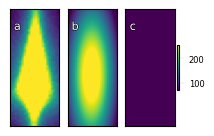

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550_later_stage at index 0.
img_sum=207040.00, img_max=255.00, img_mean=180.98
img_rec_sum=201226.14, img_rec_max=287.57, img_rec_mean=175.90
height=287.62, x=29.33, y=10.37, width_x=24.67, width_y_max=-7.93


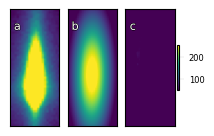

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550_later_stage at index 205000.
img_sum=153245.00, img_max=255.00, img_mean=133.96
img_rec_sum=145266.85, img_rec_max=277.25, img_rec_mean=126.98
height=277.31, x=29.22, y=10.53, width_x=18.82, width_y_max=-6.00


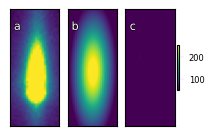

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp550_later_stage at index 410000.
img_sum=141112.00, img_max=255.00, img_mean=123.35
img_rec_sum=132590.74, img_rec_max=269.41, img_rec_mean=115.90
height=270.48, x=27.78, y=10.99, width_x=16.93, width_y_max=-5.88


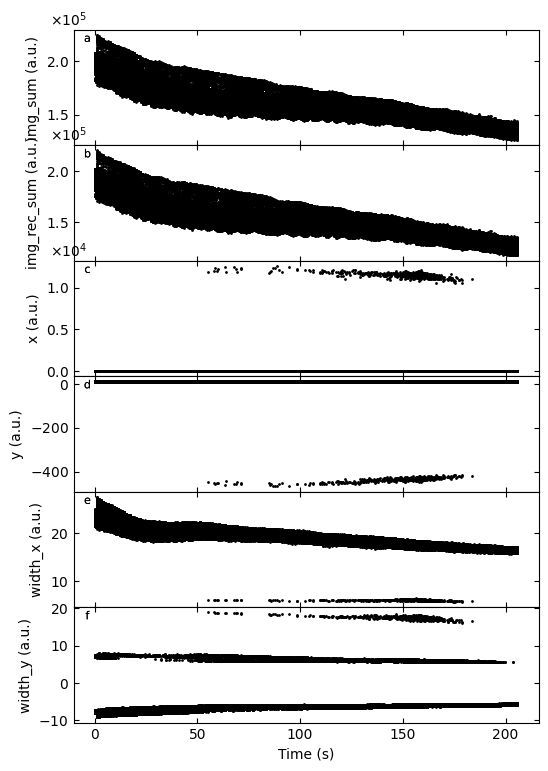

Gaussian fitted parameters in time: Fig. a: sum of original image, b: sum of reconstructed image, c: spot center in spot x coordinate, d: spot center in y coordinate, e: spot width in x coordinate, f: spot width in y coordinate.


In [35]:
parameters_file_path = 'F:/UMich/J14_PM09_gaussian_fit_parameters_08272023.h5'
D2_para = RHEED_parameter_dataset(parameters_file_path, camera_freq=2000, sample_name='PM09')

D2_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=start_index)
D2_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index//2)
D2_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index)
D2_para.viz_RHEED_parameter_trend(growth_names, spot='spot_2', head_tail=(100,300))

### 2.5 PM10

In [44]:
path = 'E:/umich_rheed/J14_PM10_600C_08272023.h5'
ds_PM10 = RHEED_spot_Dataset(path, sample_name='PM10')
ds_PM10.data_info

Growth: 30fps_temp600_later_stage, Size of data: f(507527, 480, 640)
Growth: temp600, Size of data: f(70881, 480, 640)
Growth: temp600_later_stage, Size of data: f(507527, 480, 640)


#### 2.5.2 Locate the diffraction spots

In [45]:
growth_name = 'temp600'
ds_PM10.viz_RHEED_spot(growth=growth_name, index=20000, figsize=(8,6), viz_mode='iteractive')

Fig. a: RHEED spot image for temp600 at index 20000.


<Figure size 800x600 with 0 Axes>

#### 2.5.3 Visualize an example

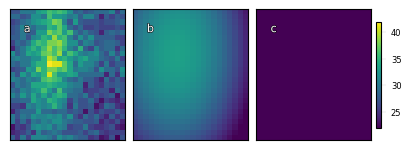

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp600 at index 0.
The Gaussian fitted parameters are: img_sum=16384.00, img_max=42.00, img_mean=29.79,
img_rec_sum=16135.87, img_rec_max=33.45, img_rec_mean=29.34,
height=33.45, x=8.23, y=8.34, width_x=27.81, width_y_max=17.11.


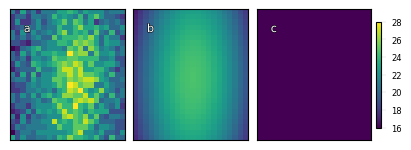

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp600 at index 70000.
The Gaussian fitted parameters are: img_sum=12121.00, img_max=28.00, img_mean=22.04,
img_rec_sum=12023.09, img_rec_max=24.58, img_rec_mean=21.86,
height=24.59, x=13.20, y=11.50, width_x=34.11, width_y_max=15.14.


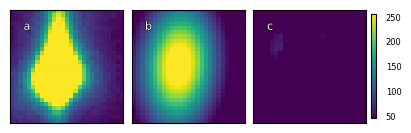

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp600 at index 0.
The Gaussian fitted parameters are: img_sum=95834.00, img_max=255.00, img_mean=131.46,
img_rec_sum=89252.73, img_rec_max=282.55, img_rec_mean=122.43,
height=283.41, x=13.39, y=11.00, width_x=10.81, width_y_max=6.49.


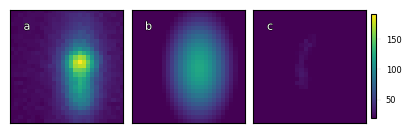

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp600 at index 70000.
The Gaussian fitted parameters are: img_sum=31848.00, img_max=191.00, img_mean=43.69,
img_rec_sum=26707.17, img_rec_max=121.91, img_rec_mean=36.64,
height=122.49, x=13.90, y=16.00, width_x=8.29, width_y_max=5.02.


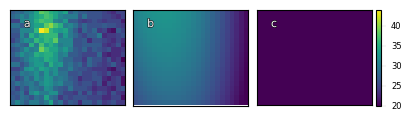

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp600 at index 0.
The Gaussian fitted parameters are: img_sum=13480.00, img_max=44.00, img_mean=28.08,
img_rec_sum=13276.03, img_rec_max=32.55, img_rec_mean=27.66,
height=33.13, x=-489.84, y=-36.71, width_x=18.61, width_y_max=53.29.


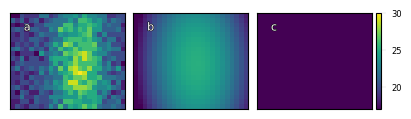

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp600 at index 70000.
The Gaussian fitted parameters are: img_sum=10645.00, img_max=30.00, img_mean=22.18,
img_rec_sum=10559.74, img_rec_max=25.19, img_rec_mean=22.00,
height=25.20, x=10.51, y=13.23, width_x=27.59, width_y_max=15.11.


In [46]:
crop_dict = {'spot_1': {'y_start':190, 'y_end':215, 'x_start':267, 'x_end':289}, 
             'spot_2': {'y_start':191, 'y_end':218, 'x_start':345, 'x_end':372}, 
             'spot_3': {'y_start':195, 'y_end':215, 'x_start':430, 'x_end':454}}
start_index, end_index = 0, 70000
fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(ds_PM10, crop_dict, fit_function)
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_1', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_1', frame=end_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_2', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_2', frame=end_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_3', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_3', frame=end_index, figsize=(4,8))

#### 2.5.4 preview metric in time

0 - 10000 ...
10000 - 20000 ...
20000 - 30000 ...
30000 - 40000 ...
40000 - 50000 ...
50000 - 60000 ...
60000 - 70000 ...
70000 - 80000 ...
80000 - 90000 ...
90000 - 100000 ...
100000 - 110000 ...
110000 - 120000 ...
120000 - 130000 ...
130000 - 140000 ...
140000 - 150000 ...
150000 - 160000 ...
160000 - 170000 ...
170000 - 180000 ...
180000 - 190000 ...
190000 - 200000 ...
200000 - 210000 ...
210000 - 220000 ...
220000 - 230000 ...
230000 - 240000 ...
240000 - 250000 ...
250000 - 260000 ...
260000 - 270000 ...
270000 - 280000 ...
280000 - 290000 ...
290000 - 300000 ...
300000 - 310000 ...
310000 - 320000 ...
320000 - 330000 ...
330000 - 340000 ...
340000 - 350000 ...
350000 - 360000 ...
360000 - 370000 ...
370000 - 380000 ...
380000 - 390000 ...
390000 - 400000 ...
400000 - 410000 ...
410000 - 420000 ...
420000 - 430000 ...
430000 - 440000 ...
440000 - 450000 ...
450000 - 460000 ...
460000 - 470000 ...
470000 - 480000 ...
480000 - 490000 ...
490000 - 499922 ...


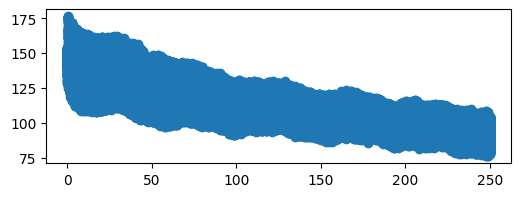

CPU times: total: 12min 8s
Wall time: 14min 45s


In [11]:
# %%time
# fit_function = Gaussian().recreate_gaussian
# processor = RHEED_image_processer(ds_spot250, crop_dict, fit_function)
# rheed_curve = processor.preview_metric(growth='temp250', spot='spot_2', metric='mean', camera_freq=2000, viz=True,
#                          process_chunk_size=10000)
# # processor.preview_metric(growth='temp250', spot='spot_2', metric='max', camera_freq=2000, process_chunk_size=10000)

#### 2.5.5 generate the dataset

In [47]:
%%time
parameters_file_path = 'F:/UMich/J14_PM10_gaussian_fit_parameters_08272023.h5'
growth_names = [growth_name]

fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(ds_PM10, crop_dict, fit_function)

processor.write_h5_file(parameters_file_path, growth_names, replace=False, num_workers=12)

temp600:
  spot_1 generation started:
    0 - 50000 ...
    50000 - 70881 ...
  spot_2 generation started:
    0 - 50000 ...
    50000 - 70881 ...
  spot_3 generation started:
    0 - 50000 ...
    50000 - 70881 ...
CPU times: total: 1min 42s
Wall time: 6min 38s


#### 2.5.6 Exam the dataset

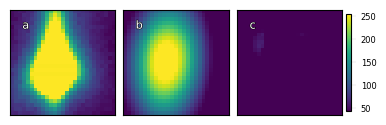

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp600 at index 0.
img_sum=95834.00, img_max=255.00, img_mean=131.46
img_rec_sum=89252.73, img_rec_max=282.55, img_rec_mean=122.43
height=283.41, x=13.39, y=11.00, width_x=10.81, width_y_max=6.49


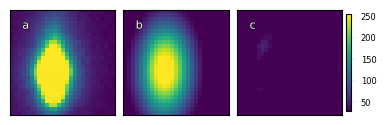

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp600 at index 35000.
img_sum=68499.00, img_max=255.00, img_mean=93.96
img_rec_sum=60056.76, img_rec_max=279.58, img_rec_mean=82.38
height=279.87, x=15.67, y=10.60, width_x=8.68, width_y_max=4.86


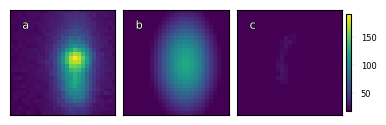

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for temp600 at index 70000.
img_sum=31848.00, img_max=191.00, img_mean=43.69
img_rec_sum=26707.17, img_rec_max=121.91, img_rec_mean=36.64
height=122.49, x=13.90, y=16.00, width_x=8.29, width_y_max=5.02


I:\RHEED_data\m3_learning\m3_learning\papers\2023_RHEED_PLD_SrTiO3 - UMich\../../src\m3_learning\RHEED\Dataset.py:432: UserWarning:

FixedFormatter should only be used together with FixedLocator



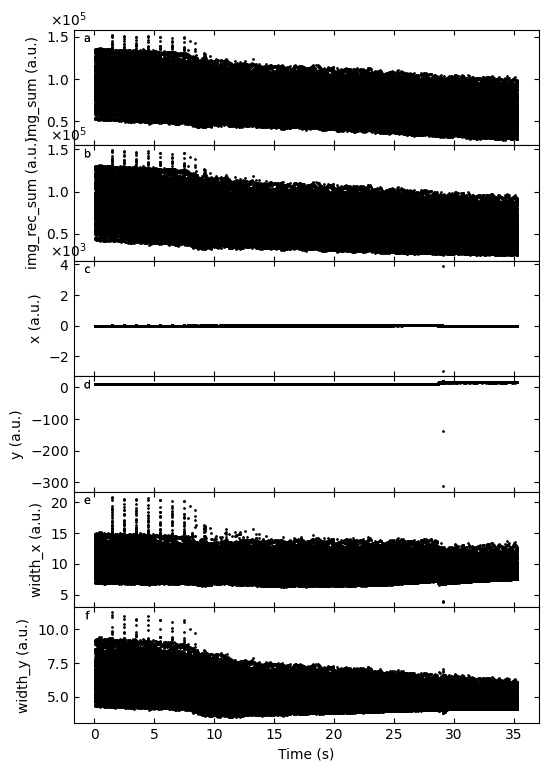

Gaussian fitted parameters in time: Fig. a: sum of original image, b: sum of reconstructed image, c: spot center in spot x coordinate, d: spot center in y coordinate, e: spot width in x coordinate, f: spot width in y coordinate.


In [48]:
parameters_file_path = 'F:/UMich/J14_PM10_gaussian_fit_parameters_08272023.h5'
D2_para = RHEED_parameter_dataset(parameters_file_path, camera_freq=2000, sample_name='PM10')

D2_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=start_index)
D2_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index//2)
D2_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index)
D2_para.viz_RHEED_parameter_trend(growth_names, spot='spot_2', head_tail=(100,300))

### 2.6 PM10_later_stage

In [56]:
path = 'E:/umich_rheed/J14_PM10_600C_08272023.h5'
ds_PM10 = RHEED_spot_Dataset(path, sample_name='PM10')
ds_PM10.data_info

Growth: 30fps_temp600_later_stage, Size of data: f(507527, 480, 640)
Growth: temp600, Size of data: f(70881, 480, 640)
Growth: temp600_later_stage, Size of data: f(507527, 480, 640)


#### 2.6.1 Locate the diffraction spots

In [60]:
growth_name = '30fps_temp600_later_stage'
ds_PM10.viz_RHEED_spot(growth=growth_name, index=0, figsize=(8,6), viz_mode='iteractive')

Fig. a: RHEED spot image for 30fps_temp600_later_stage at index 0.


<Figure size 800x600 with 0 Axes>

#### 2.6.2 Visualize an example

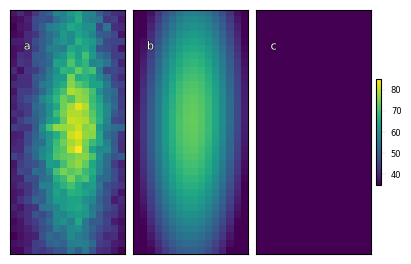

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for 30fps_temp600_later_stage at index 0.
The Gaussian fitted parameters are: img_sum=29379.00, img_max=85.00, img_mean=54.01,
img_rec_sum=28509.48, img_rec_max=73.13, img_rec_mean=52.41,
height=73.19, x=15.37, y=8.26, width_x=21.62, width_y_max=6.95.


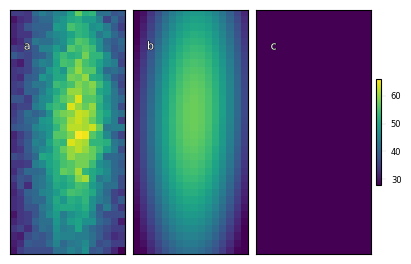

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for 30fps_temp600_later_stage at index 500000.
The Gaussian fitted parameters are: img_sum=24511.00, img_max=66.00, img_mean=45.06,
img_rec_sum=23948.79, img_rec_max=57.50, img_rec_mean=44.02,
height=57.50, x=14.46, y=8.48, width_x=24.90, width_y_max=7.85.


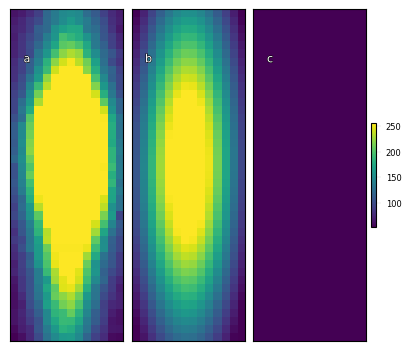

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for 30fps_temp600_later_stage at index 0.
The Gaussian fitted parameters are: img_sum=100124.00, img_max=255.00, img_mean=174.43,
img_rec_sum=95356.80, img_rec_max=298.70, img_rec_mean=166.13,
height=299.56, x=19.22, y=6.82, width_x=16.74, width_y_max=4.78.


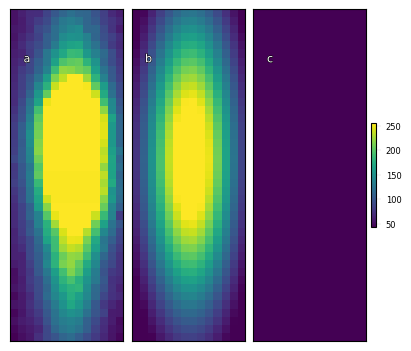

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for 30fps_temp600_later_stage at index 500000.
The Gaussian fitted parameters are: img_sum=86294.00, img_max=255.00, img_mean=150.34,
img_rec_sum=81487.94, img_rec_max=291.95, img_rec_mean=141.97,
height=292.86, x=18.51, y=7.19, width_x=14.27, width_y_max=4.37.


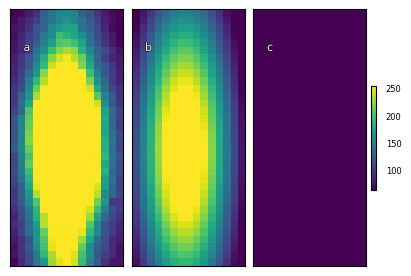

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for 30fps_temp600_later_stage at index 0.
The Gaussian fitted parameters are: img_sum=90802.00, img_max=255.00, img_mean=178.04,
img_rec_sum=86549.56, img_rec_max=297.82, img_rec_mean=169.71,
height=299.05, x=18.86, y=6.86, width_x=16.03, width_y_max=4.90.


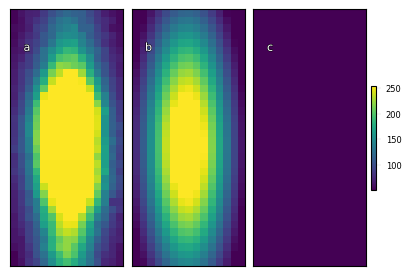

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for 30fps_temp600_later_stage at index 500000.
The Gaussian fitted parameters are: img_sum=79561.00, img_max=255.00, img_mean=156.00,
img_rec_sum=75173.93, img_rec_max=295.20, img_rec_mean=147.40,
height=295.90, x=18.11, y=7.23, width_x=13.46, width_y_max=-4.42.


In [61]:
crop_dict = {'spot_1': {'y_start':160, 'y_end':194, 'x_start':194, 'x_end':210}, 
             'spot_2': {'y_start':160, 'y_end':201, 'x_start':278, 'x_end':292}, 
             'spot_3': {'y_start':160, 'y_end':194, 'x_start':278, 'x_end':293}}
start_index, end_index = 0, 500000
fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(ds_PM10, crop_dict, fit_function)
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_1', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_1', frame=end_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_2', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_2', frame=end_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_3', frame=start_index, figsize=(4,8))
img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_3', frame=end_index, figsize=(4,8))

#### 2.6.3 preview metric in time

0 - 10000 ...
10000 - 20000 ...
20000 - 30000 ...
30000 - 40000 ...
40000 - 50000 ...
50000 - 60000 ...
60000 - 70000 ...
70000 - 80000 ...
80000 - 90000 ...
90000 - 100000 ...
100000 - 110000 ...
110000 - 120000 ...
120000 - 130000 ...
130000 - 140000 ...
140000 - 150000 ...
150000 - 160000 ...
160000 - 170000 ...
170000 - 180000 ...
180000 - 190000 ...
190000 - 200000 ...
200000 - 210000 ...
210000 - 220000 ...
220000 - 230000 ...
230000 - 240000 ...
240000 - 250000 ...
250000 - 260000 ...
260000 - 270000 ...
270000 - 280000 ...
280000 - 290000 ...
290000 - 300000 ...
300000 - 310000 ...
310000 - 320000 ...
320000 - 330000 ...
330000 - 340000 ...
340000 - 350000 ...
350000 - 360000 ...
360000 - 370000 ...
370000 - 380000 ...
380000 - 390000 ...
390000 - 400000 ...
400000 - 410000 ...
410000 - 420000 ...
420000 - 430000 ...
430000 - 440000 ...
440000 - 450000 ...
450000 - 460000 ...
460000 - 470000 ...
470000 - 480000 ...
480000 - 490000 ...
490000 - 500000 ...
500000 - 509165 ...


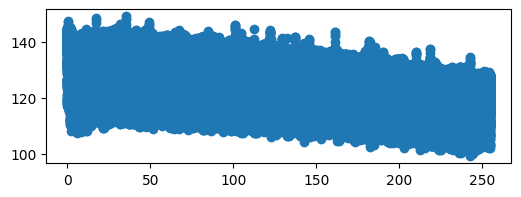

CPU times: total: 3min 22s
Wall time: 4min 2s


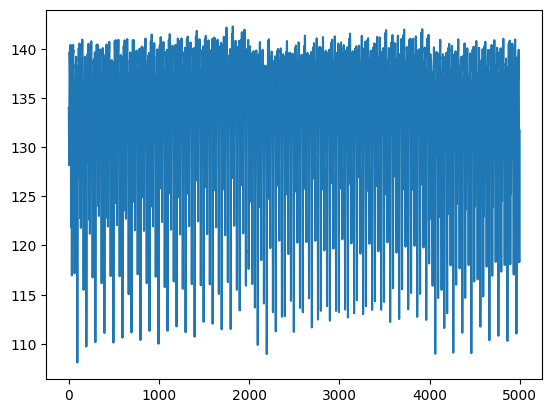

In [29]:
# %%time
# fit_function = Gaussian().recreate_gaussian
# processor = RHEED_image_processer(ds_spot250, crop_dict, fit_function)
# rheed_curve = processor.preview_metric(growth='temp250_later_stage', spot='spot_2', metric='mean', camera_freq=2000, viz=True,
#                          process_chunk_size=10000)
# # processor.preview_metric(growth='temp250', spot='spot_2', metric='max', camera_freq=2000, process_chunk_size=10000)

# plt.plot(rheed_curve[5000:10000])

#### 2.6.4 generate the dataset

In [63]:
%%time
parameters_file_path = 'F:/UMich/J14_PM10_gaussian_fit_parameters_08272023.h5'
growth_names = ['temp600_later_stage', '30fps_temp600_later_stage']

fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(ds_PM10, crop_dict, fit_function)

processor.write_h5_file(parameters_file_path, growth_names, replace=False, num_workers=12, process_chunk_size=50000)

h5 file exist.
temp600_later_stage:
  spot_1 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 400000 ...
    400000 - 450000 ...
    450000 - 500000 ...
    500000 - 507527 ...
  spot_2 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 400000 ...
    400000 - 450000 ...
    450000 - 500000 ...
    500000 - 507527 ...
  spot_3 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    100000 - 150000 ...
    150000 - 200000 ...
    200000 - 250000 ...
    250000 - 300000 ...
    300000 - 350000 ...
    350000 - 400000 ...
    400000 - 450000 ...
    450000 - 500000 ...
    500000 - 507527 ...
30fps_temp600_later_stage:
  spot_1 generation started:
    0 - 50000 ...
    50000 - 100000 ...
    10000

#### 2.6.5 Exam the dataset

Growth: 30fps_temp600_later_stage:
--spot: spot_1:
----height:, Size of data: (507527,)
----img_max:, Size of data: (507527,)
----img_mean:, Size of data: (507527,)
----img_rec_max:, Size of data: (507527,)
----img_rec_mean:, Size of data: (507527,)
----img_rec_sum:, Size of data: (507527,)
----img_sum:, Size of data: (507527,)
----raw_image:, Size of data: (507527, 34, 16)
----reconstructed_image:, Size of data: (507527, 34, 16)
----width_x:, Size of data: (507527,)
----width_y:, Size of data: (507527,)
----x:, Size of data: (507527,)
----y:, Size of data: (507527,)
--spot: spot_2:
----height:, Size of data: (507527,)
----img_max:, Size of data: (507527,)
----img_mean:, Size of data: (507527,)
----img_rec_max:, Size of data: (507527,)
----img_rec_mean:, Size of data: (507527,)
----img_rec_sum:, Size of data: (507527,)
----img_sum:, Size of data: (507527,)
----raw_image:, Size of data: (507527, 41, 14)
----reconstructed_image:, Size of data: (507527, 41, 14)
----width_x:, Size of data:

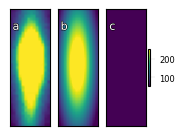

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for 30fps_temp600_later_stage at index 0.
img_sum=100124.00, img_max=255.00, img_mean=174.43
img_rec_sum=95356.80, img_rec_max=298.70, img_rec_mean=166.13
height=299.56, x=19.22, y=6.82, width_x=16.74, width_y_max=4.78


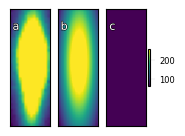

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for 30fps_temp600_later_stage at index 250000.
img_sum=113246.00, img_max=255.00, img_mean=197.29
img_rec_sum=109533.58, img_rec_max=297.18, img_rec_mean=190.83
height=297.26, x=18.38, y=7.41, width_x=20.30, width_y_max=5.54


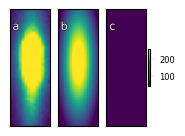

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for 30fps_temp600_later_stage at index 500000.
img_sum=86294.00, img_max=255.00, img_mean=150.34
img_rec_sum=81487.94, img_rec_max=291.95, img_rec_mean=141.97
height=292.86, x=18.51, y=7.19, width_x=14.27, width_y_max=4.37


I:\RHEED_data\m3_learning\m3_learning\papers\2023_RHEED_PLD_SrTiO3 - UMich\../../src\m3_learning\RHEED\Dataset.py:432: UserWarning:

FixedFormatter should only be used together with FixedLocator



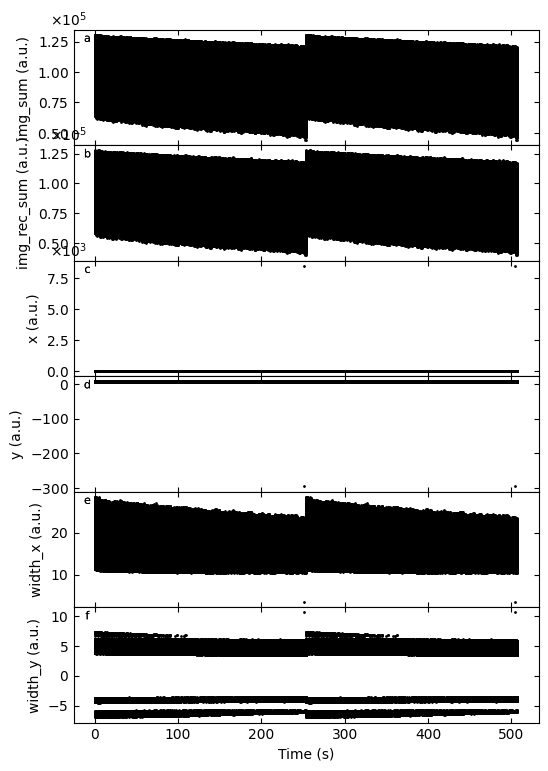

Gaussian fitted parameters in time: Fig. a: sum of original image, b: sum of reconstructed image, c: spot center in spot x coordinate, d: spot center in y coordinate, e: spot width in x coordinate, f: spot width in y coordinate.


In [65]:
parameters_file_path = 'F:/UMich/J14_PM10_gaussian_fit_parameters_08272023.h5'
para_PM10 = RHEED_parameter_dataset(parameters_file_path, camera_freq=2000, sample_name='PM10')
para_PM10.data_info

D2_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=start_index)
D2_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index//2)
D2_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index)
D2_para.viz_RHEED_parameter_trend(growth_names, spot='spot_2', head_tail=(100,300))